In [68]:
import numpy as np
import pandas as pd
import sklearn
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import accuracy_score, confusion_matrix,classification_report
from sklearn.model_selection import train_test_split
import warnings
warnings.filterwarnings("ignore")
df = pd.read_csv('phase2_project_12_temperature.csv')

In [69]:
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,30-06-2013,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,30-06-2013,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,30-08-2017,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,30-08-2017,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,30-08-2017,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [70]:
df["Next_Tmin"].unique()

array([21.2, 22.5, 23.9, 24.3, 24. , 23.4, 22.9, 21.6, 21. , 24.5, 22.2,
       22.8, 20.9, 21.1, 23. , 23.7, 23.2, 24.2, 18.7, 21.5, 21.8, 22.3,
       21.3, 20.7, 19.8, 20.8, 21.7, 22.1, 20.5, 21.9, 17.8, 20.1, 20.3,
       19.4, 19.1, 18.9, 20. , 19.7, 19.5, 20.6, 23.1, 23.3, 22.7, 22.6,
       22.4, 22. , 23.5, 23.8, 21.4, 19.3, 20.4, 19.9, 20.2, 24.1, 23.6,
       24.4, 24.8, 25.1, 24.6, 24.7, 25. , 24.9, 25.3, 26. , 26.1, 25.5,
       25.8, 25.4, 25.6, 25.7, 25.2, 25.9, 26.3, 26.2, 26.4, 26.5, 26.9,
        nan, 26.8, 26.6, 27. , 27.1, 26.7, 27.5, 27.2, 27.4, 27.7, 28.3,
       27.6, 28. , 27.3, 19.6, 19.2, 18.6, 18.5, 18.2, 18.4, 18.8, 17.9,
       17.5, 16.5, 18. , 19. , 16.7, 18.1, 18.3, 28.1, 28.4, 29.4, 29.1,
       28.5, 28.8, 29.8, 29.5, 28.6, 17.1, 16.8, 17.6, 17.4, 15.8, 16.9,
       17.7, 17.2, 15.5, 16.6, 16.4, 16.3, 17. , 14.7, 15.9, 16. , 17.3,
       15.4, 15.3, 13.8, 15.6, 15.1, 27.9, 28.7, 27.8, 28.2, 13.3, 14.1,
       15. , 11.3, 13.4, 15.7, 14.9, 16.2, 14.4, 16

Note1: Regression model will be applied

In [71]:
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [72]:
df.shape

(7752, 25)

In [73]:
df.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [74]:
df= df.drop_duplicates() # Removing duplicate entries
df.shape

(7752, 25)

In [75]:
categorical_col =[]
for i in df.dtypes.index:
    if df.dtypes[i] == "object":
        categorical_col.append(i)
print("Categorical Columns: ", categorical_col)
print("\n")
num_col =[]
for i in df.dtypes.index:
    if df.dtypes[i] != "object":
        num_col.append(i)
print("Numerical Columns: ", num_col)
print("\n")

Categorical Columns:  ['Date']


Numerical Columns:  ['station', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin', 'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS', 'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope', 'Solar radiation', 'Next_Tmax', 'Next_Tmin']




# EDA
1. Null/NaN

In [76]:
df.isnull().sum()

station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64

<Axes: >

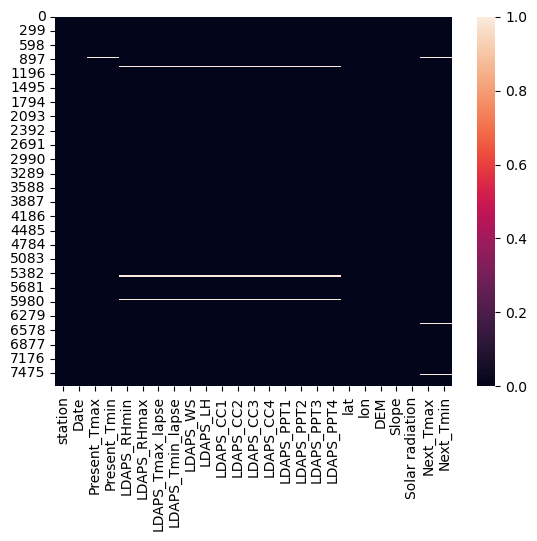

In [77]:
sns.heatmap(df.isnull())

In [78]:
y= ['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation', 'Next_Tmax','Next_Tmin']
for x in y:
    df[x]=df[x].fillna(df[x].mode()[0])
df.isnull().sum()

station             0
Date                0
Present_Tmax        0
Present_Tmin        0
LDAPS_RHmin         0
LDAPS_RHmax         0
LDAPS_Tmax_lapse    0
LDAPS_Tmin_lapse    0
LDAPS_WS            0
LDAPS_LH            0
LDAPS_CC1           0
LDAPS_CC2           0
LDAPS_CC3           0
LDAPS_CC4           0
LDAPS_PPT1          0
LDAPS_PPT2          0
LDAPS_PPT3          0
LDAPS_PPT4          0
lat                 0
lon                 0
DEM                 0
Slope               0
Solar radiation     0
Next_Tmax           0
Next_Tmin           0
dtype: int64

In [79]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7752 non-null   float64
 1   Date              7752 non-null   object 
 2   Present_Tmax      7752 non-null   float64
 3   Present_Tmin      7752 non-null   float64
 4   LDAPS_RHmin       7752 non-null   float64
 5   LDAPS_RHmax       7752 non-null   float64
 6   LDAPS_Tmax_lapse  7752 non-null   float64
 7   LDAPS_Tmin_lapse  7752 non-null   float64
 8   LDAPS_WS          7752 non-null   float64
 9   LDAPS_LH          7752 non-null   float64
 10  LDAPS_CC1         7752 non-null   float64
 11  LDAPS_CC2         7752 non-null   float64
 12  LDAPS_CC3         7752 non-null   float64
 13  LDAPS_CC4         7752 non-null   float64
 14  LDAPS_PPT1        7752 non-null   float64
 15  LDAPS_PPT2        7752 non-null   float64
 16  LDAPS_PPT3        7752 non-null   float64


In [80]:
df.nunique().to_frame("No of unique values")

,No of unique values
station,25
Date,310
Present_Tmax,167
Present_Tmin,155
LDAPS_RHmin,7672
LDAPS_RHmax,7664
LDAPS_Tmax_lapse,7675
LDAPS_Tmin_lapse,7675
LDAPS_WS,7675
LDAPS_LH,7675


# 2. Label Encoder

In [81]:
from sklearn.preprocessing import OrdinalEncoder
OE=OrdinalEncoder()
for i in df.columns:
    if df[i].dtypes=="object":
        df[i] = OE.fit_transform(df[i].values.reshape(-1,1))
        
df

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,290.0,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.000000,0.000000,0.000000,37.6046,126.991,212.3350,2.785000,5992.895996,29.1,21.2
1,2.0,290.0,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.000000,0.000000,0.000000,37.6046,127.032,44.7624,0.514100,5869.312500,30.5,22.5
2,3.0,290.0,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.000000,0.000000,0.000000,37.5776,127.058,33.3068,0.266100,5863.555664,31.1,23.9
3,4.0,290.0,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.000000,0.000000,0.000000,37.6450,127.022,45.7160,2.534800,5856.964844,31.7,24.3
4,5.0,290.0,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.000000,0.000000,0.000000,37.5507,127.135,35.0380,0.505500,5859.552246,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7747,23.0,304.0,23.3,17.1,26.741310,78.869858,26.352081,18.775678,6.148918,72.058294,...,0.000000,0.000000,0.000000,37.5372,126.891,15.5876,0.155400,4443.313965,28.3,18.1
7748,24.0,304.0,23.3,17.7,24.040634,77.294975,27.010193,18.733519,6.542819,47.241457,...,0.000000,0.000000,0.000000,37.5237,126.909,17.2956,0.222300,4438.373535,28.6,18.8
7749,25.0,304.0,23.2,17.4,22.933014,77.243744,27.939516,18.522965,7.289264,9.090034,...,0.000000,0.000000,0.000000,37.5237,126.970,19.5844,0.271300,4451.345215,27.8,17.4
7750,1.0,0.0,20.0,11.3,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.4562,126.826,12.3700,0.098475,4329.520508,17.4,11.3


In [82]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 25 columns):
 #   Column            Non-Null Count  Dtype  
---  ------            --------------  -----  
 0   station           7752 non-null   float64
 1   Date              7752 non-null   float64
 2   Present_Tmax      7752 non-null   float64
 3   Present_Tmin      7752 non-null   float64
 4   LDAPS_RHmin       7752 non-null   float64
 5   LDAPS_RHmax       7752 non-null   float64
 6   LDAPS_Tmax_lapse  7752 non-null   float64
 7   LDAPS_Tmin_lapse  7752 non-null   float64
 8   LDAPS_WS          7752 non-null   float64
 9   LDAPS_LH          7752 non-null   float64
 10  LDAPS_CC1         7752 non-null   float64
 11  LDAPS_CC2         7752 non-null   float64
 12  LDAPS_CC3         7752 non-null   float64
 13  LDAPS_CC4         7752 non-null   float64
 14  LDAPS_PPT1        7752 non-null   float64
 15  LDAPS_PPT2        7752 non-null   float64
 16  LDAPS_PPT3        7752 non-null   float64


In [45]:
df.describe() # We donot remove Skewness and Outliars from cataegorial columns.

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,...,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000
mean,12.996904,154.460139,29.782946,23.232056,56.401741,88.089988,29.497459,23.423193,7.057092,61.768678,...,0.480310,0.275508,0.266801,37.544722,126.991397,61.867972,1.257048,5341.502803,30.271491,22.934198
std,7.213213,89.517454,2.960585,2.404154,15.038788,7.715499,3.158976,2.503109,2.212072,34.383864,...,1.754900,1.156495,1.200654,0.050352,0.079435,54.279780,1.370444,429.158867,3.123085,2.483502
min,1.000000,0.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,77.000000,27.800000,21.700000,45.735368,84.038809,27.601014,22.032374,5.647741,36.776474,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.400000
50%,13.000000,154.000000,30.000000,23.400000,54.828714,89.699505,29.662273,23.735942,6.531345,56.487289,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,232.000000,32.000000,24.900000,67.038254,93.704500,31.683819,25.134000,8.007471,83.904586,...,0.016748,0.007231,0.000000,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,309.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


## Column count is same: No missing data

- There is no negative/valid _ Dataset is OK
- Std Deviation is high for "Solar Radiation"
- Median (50%) > Mean - "Solar radiation" --> Left Skewed
- Median (50%) < Mean - LDAPS_RHmin,LDAPS_LH,DEM, -> Right Skewed
- Percentile 75% and max : "LDAPS_RHmin","LDAPS_WS",LDAPS_LH- outliars are present

In [46]:
df.skew()

station             0.000100
Date                0.000009
Present_Tmax       -0.276483
Present_Tmin       -0.375457
LDAPS_RHmin         0.202176
LDAPS_RHmax        -1.109283
LDAPS_Tmax_lapse   -0.601161
LDAPS_Tmin_lapse   -0.851245
LDAPS_WS            1.485885
LDAPS_LH            0.586176
LDAPS_CC1           0.460727
LDAPS_CC2           0.474379
LDAPS_CC3           0.643064
LDAPS_CC4           0.671739
LDAPS_PPT1          5.395178
LDAPS_PPT2          5.776835
LDAPS_PPT3          6.458608
LDAPS_PPT4          6.826930
lat                 0.087062
lon                -0.285213
DEM                 1.723257
Slope               1.563020
Solar radiation    -0.511210
Next_Tmax          -0.336871
Next_Tmin          -0.406685
dtype: float64

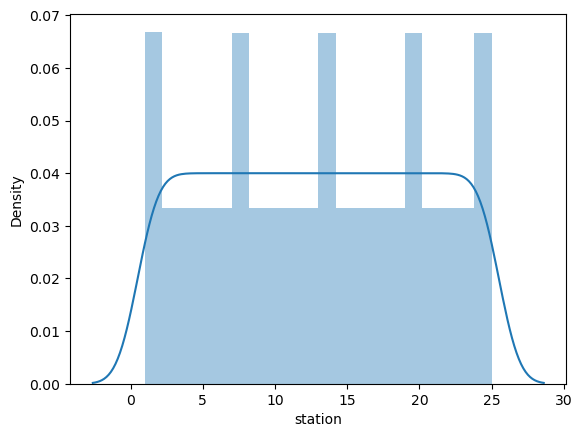

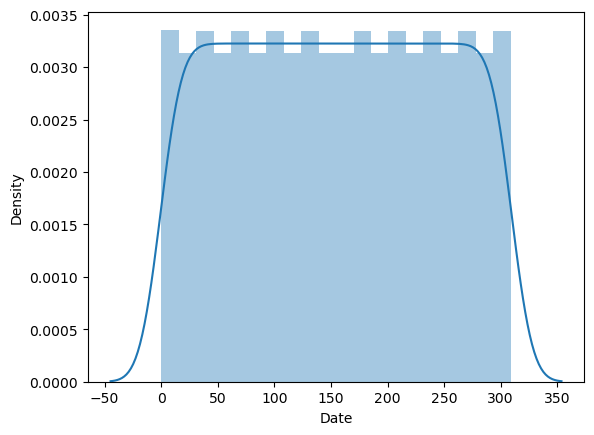

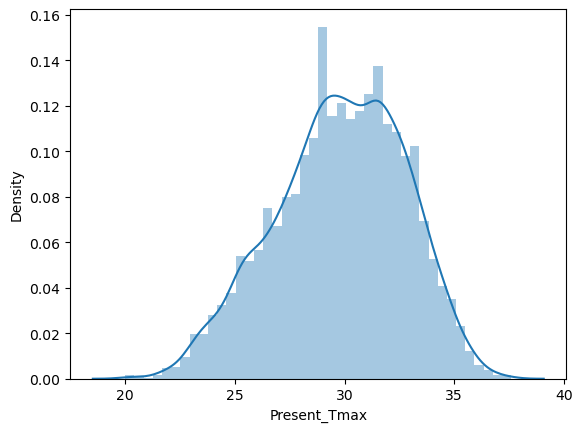

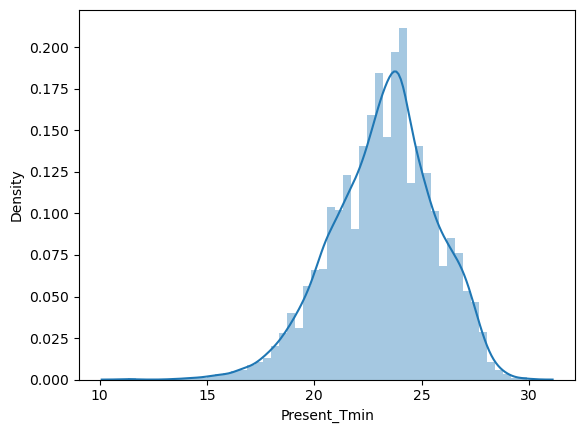

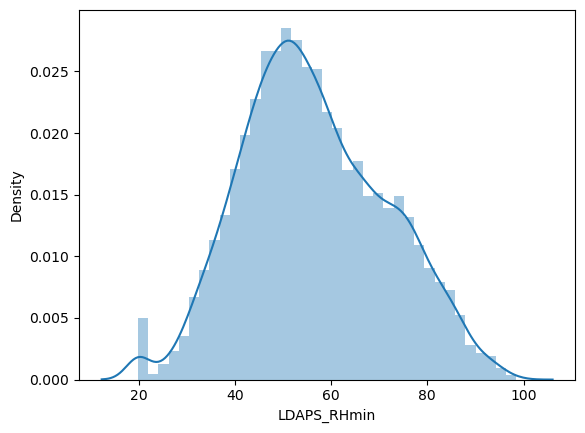

...

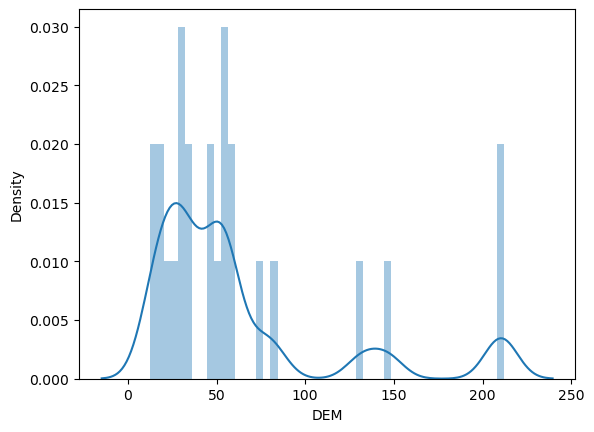

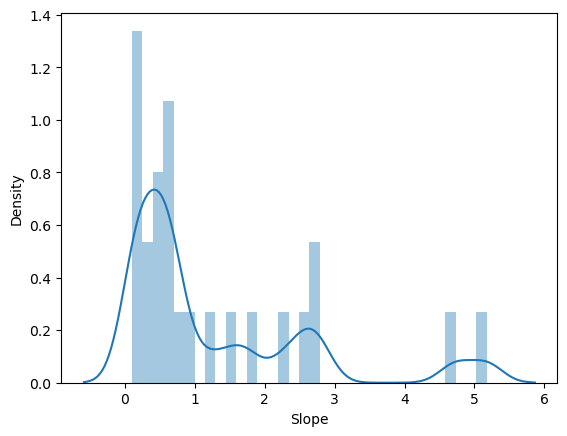

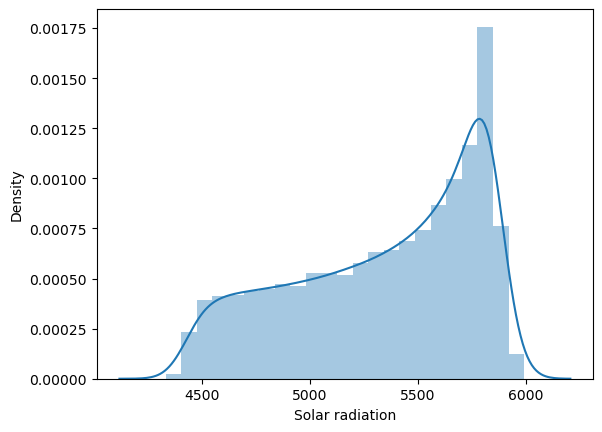

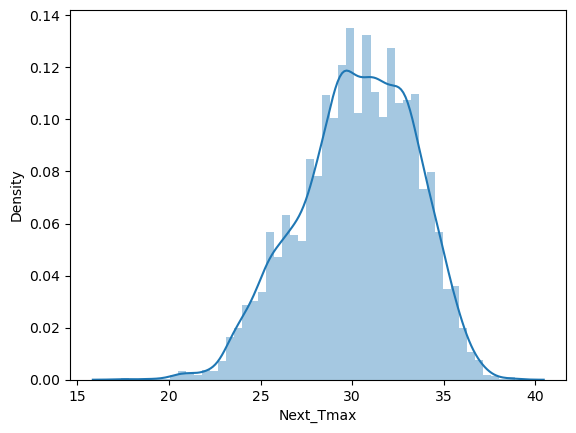

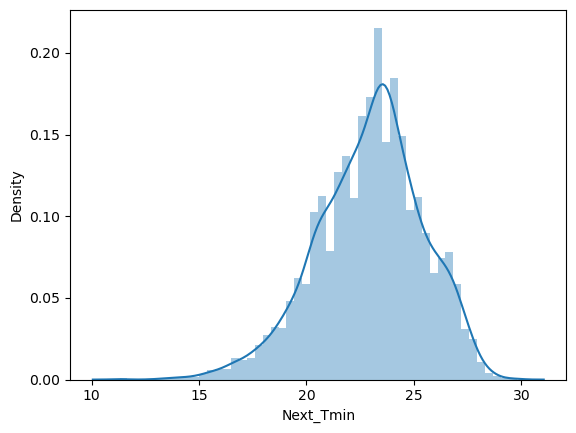

In [47]:
for i in df.columns: # Skewness
    plt.figure()
    sns.distplot(df[i])

## We donot remove Skewness and Outliars from categorial columns.

station                Axes(0.125,0.825775;0.168478x0.0542254)
Date                Axes(0.327174,0.825775;0.168478x0.0542254)
Present_Tmax        Axes(0.529348,0.825775;0.168478x0.0542254)
Present_Tmin        Axes(0.731522,0.825775;0.168478x0.0542254)
LDAPS_RHmin            Axes(0.125,0.760704;0.168478x0.0542254)
LDAPS_RHmax         Axes(0.327174,0.760704;0.168478x0.0542254)
LDAPS_Tmax_lapse    Axes(0.529348,0.760704;0.168478x0.0542254)
LDAPS_Tmin_lapse    Axes(0.731522,0.760704;0.168478x0.0542254)
LDAPS_WS               Axes(0.125,0.695634;0.168478x0.0542254)
LDAPS_LH            Axes(0.327174,0.695634;0.168478x0.0542254)
LDAPS_CC1           Axes(0.529348,0.695634;0.168478x0.0542254)
LDAPS_CC2           Axes(0.731522,0.695634;0.168478x0.0542254)
LDAPS_CC3              Axes(0.125,0.630563;0.168478x0.0542254)
LDAPS_CC4           Axes(0.327174,0.630563;0.168478x0.0542254)
LDAPS_PPT1          Axes(0.529348,0.630563;0.168478x0.0542254)
LDAPS_PPT2          Axes(0.731522,0.630563;0.168478x0.0

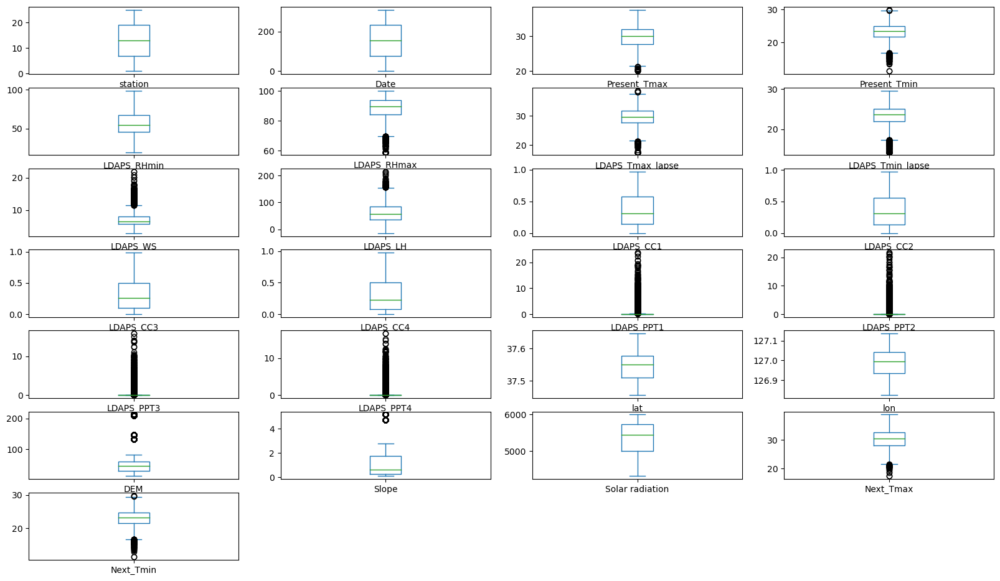

In [48]:
df.plot(kind='box',subplots=True,layout=(12,4),figsize=(20,20))

Outliars observed in 'Present_Tmax', 'Present_Tmin', 
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 
       'DEM', 'Slope', 'Next_Tmax', 'Next_Tmin' 

In [83]:
from scipy.stats import zscore
ol = ["Present_Tmax", "Present_Tmin", "LDAPS_RHmax", "LDAPS_Tmax_lapse", "LDAPS_Tmin_lapse", "LDAPS_WS", "LDAPS_LH", "LDAPS_PPT1", "LDAPS_PPT2", "LDAPS_PPT3", "LDAPS_PPT4", "DEM", "Slope", "Next_Tmax", "Next_Tmin"]
for i in ol:
    col = df[i]
    z=zscore(col)
    thresh =3
    df1 = df[(z < thresh) & (z > -thresh)]

print("Data loss rate",((df.shape[0]-df1.shape[0])/df.shape[0])*100)


Data loss rate 0.42569659442724456


# Data Loss is less than 1%

# 4. Co- Relation and Multicolinearity

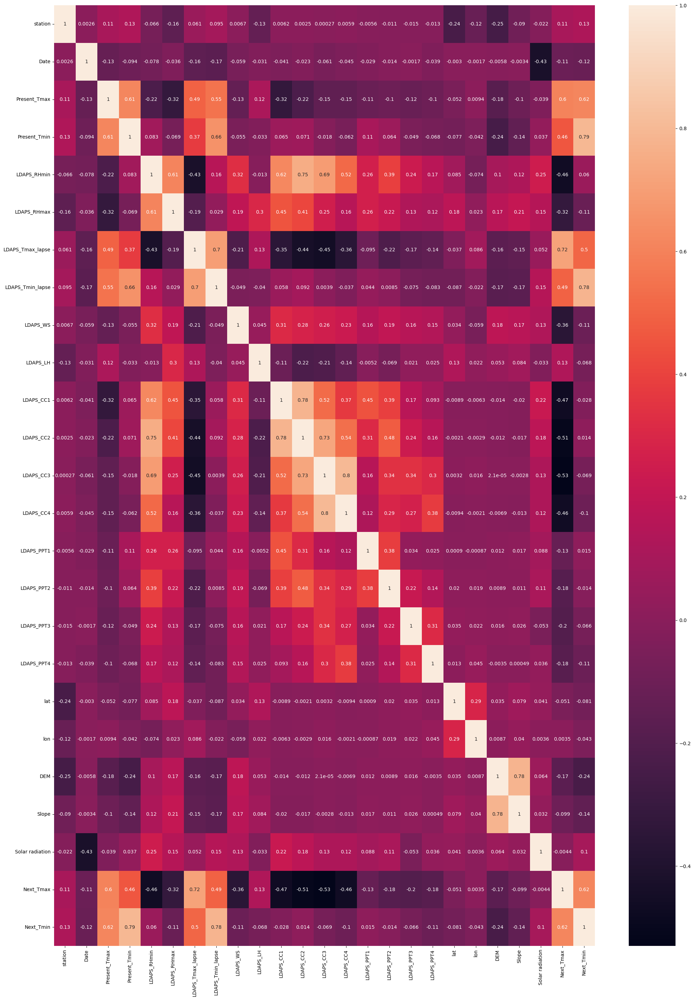

In [50]:
corr_hmap=df1.corr()
plt.figure(figsize=(25,35))
sns.heatmap(corr_hmap,annot=True)
plt.show()

- Near to Zero : No Corelation- Low Corelation Worst - [station ,Date ,LDAPS_RHmax ,LDAPS_WS ,LDAPS_LH ,LDAPS_CC1 ,LDAPS_CC2 ,LDAPS_CC3 ,LDAPS_CC4 ,LDAPS_PPT1 ,LDAPS_PPT2 ,LDAPS_PPT3 ,LDAPS_PPT4 ,lat ,lon ,DEM ,Slope ,Solar radiation, LDAPS_RHmin]
- 0.5 or >-0.5 --> Mod Corelation -  ["Present_Tmax","LDAPS_Tmax_lapse","Next Tmax"]
- 0.7 or >-0.7 --> High Corelation - ["LDAPS_Tmin_lapse","Present_Tmin"]

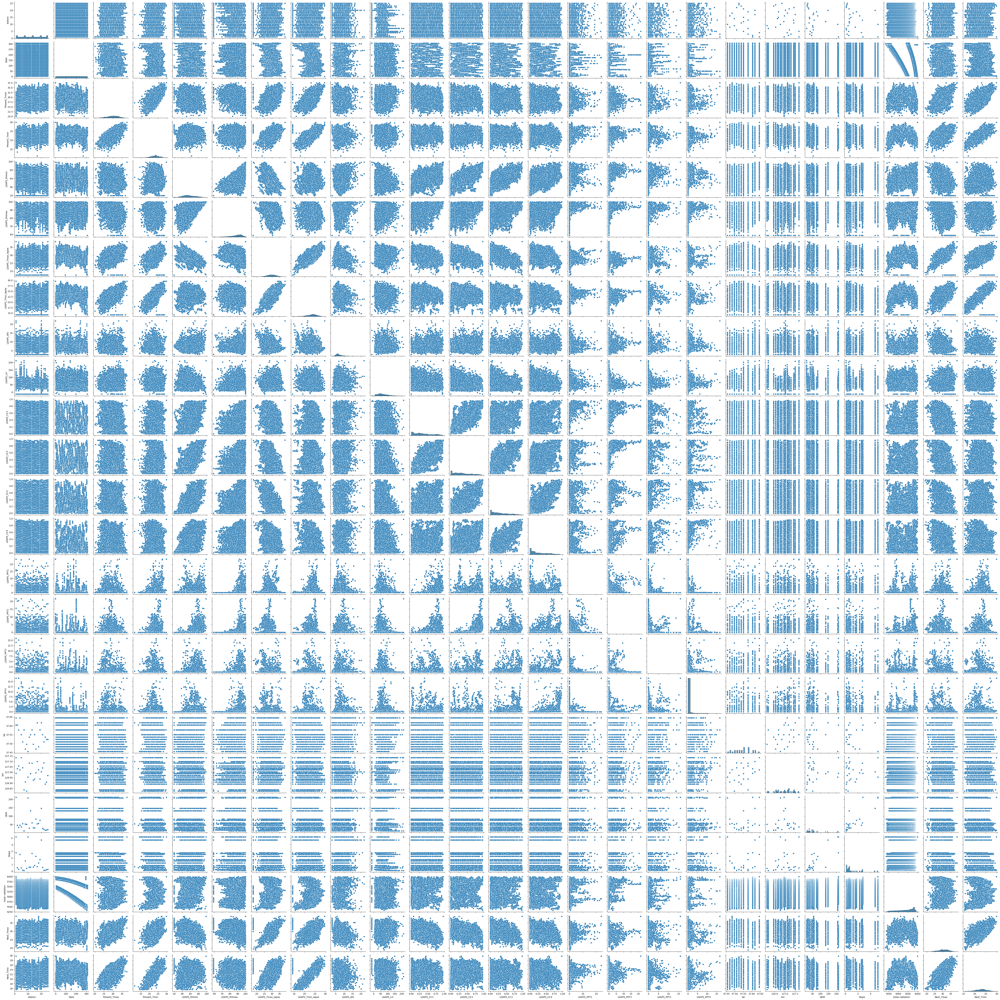

In [51]:
sns.pairplot(df1)

In [52]:
cor=df1.corr()
cor

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
station,1.000000,0.002562,0.108612,0.128978,-0.066109,-0.156603,0.061297,0.095428,0.006677,-0.131915,...,-0.010875,-0.014643,-0.013212,-0.238743,-0.120172,-0.254871,-0.089727,-0.021923,0.105561,0.127407
Date,0.002562,1.000000,-0.128660,-0.093962,-0.078404,-0.036324,-0.157495,-0.170415,-0.059161,-0.031273,...,-0.013846,-0.001663,-0.039348,-0.002975,-0.001676,-0.005850,-0.003422,-0.427834,-0.108690,-0.115589
Present_Tmax,0.108612,-0.128660,1.000000,0.611735,-0.223766,-0.316007,0.494342,0.545829,-0.131974,0.119436,...,-0.103399,-0.122423,-0.102169,-0.052112,0.009382,-0.180656,-0.102572,-0.039086,0.603050,0.616734
Present_Tmin,0.128978,-0.093962,0.611735,1.000000,0.082930,-0.068698,0.373803,0.656975,-0.055354,-0.032619,...,0.063833,-0.049270,-0.067703,-0.076877,-0.042129,-0.244664,-0.143427,0.037329,0.461304,0.791000
LDAPS_RHmin,-0.066109,-0.078404,-0.223766,0.082930,1.000000,0.610707,-0.427508,0.162167,0.324820,-0.012830,...,0.385693,0.237244,0.168005,0.084749,-0.073663,0.102306,0.123571,0.246821,-0.463909,0.060038
LDAPS_RHmax,-0.156603,-0.036324,-0.316007,-0.068698,0.610707,1.000000,-0.189335,0.028641,0.191564,0.297780,...,0.222253,0.132658,0.116929,0.180702,0.023023,0.167077,0.206807,0.153707,-0.317562,-0.114062
LDAPS_Tmax_lapse,0.061297,-0.157495,0.494342,0.373803,-0.427508,-0.189335,1.000000,0.696875,-0.214163,0.126329,...,-0.217294,-0.165370,-0.142137,-0.037069,0.085514,-0.159868,-0.148067,0.051658,0.718804,0.504578
LDAPS_Tmin_lapse,0.095428,-0.170415,0.545829,0.656975,0.162167,0.028641,0.696875,1.000000,-0.049268,-0.040116,...,0.008490,-0.074735,-0.083281,-0.087483,-0.022390,-0.173977,-0.169568,0.152174,0.493950,0.780797
LDAPS_WS,0.006677,-0.059161,-0.131974,-0.055354,0.324820,0.191564,-0.214163,-0.049268,1.000000,0.045078,...,0.193599,0.159999,0.145245,0.034494,-0.059005,0.184882,0.168254,0.133106,-0.360434,-0.111586
LDAPS_LH,-0.131915,-0.031273,0.119436,-0.032619,-0.012830,0.297780,0.126329,-0.040116,0.045078,1.000000,...,-0.069467,0.021268,0.024793,0.127848,0.022309,0.052546,0.084411,-0.033351,0.130103,-0.067568


In [84]:
df5 = df1
df_pr1=df1
from statsmodels.stats.outliers_influence import variance_inflation_factor
x=df_pr1.iloc[:,0:-1]
def vif_cal():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)
vif_cal()

       VIF Factor          features
0        5.095106           station
1        5.124263              Date
2      297.297715      Present_Tmax
3      257.847094      Present_Tmin
4      100.280422       LDAPS_RHmin
5      329.989706       LDAPS_RHmax
6      658.803517  LDAPS_Tmax_lapse
7      739.854088  LDAPS_Tmin_lapse
8       15.026821          LDAPS_WS
9        6.566151          LDAPS_LH
10      10.504873         LDAPS_CC1
11      15.193318         LDAPS_CC2
12      13.743649         LDAPS_CC3
13       7.223331         LDAPS_CC4
14       1.552249        LDAPS_PPT1
15       1.620485        LDAPS_PPT2
16       1.343377        LDAPS_PPT3
17       1.336345        LDAPS_PPT4
18  651602.318316               lat
19  649504.496776               lon
20       7.176864               DEM
21       5.458142             Slope
22     222.621392   Solar radiation
23     353.439625         Next_Tmax


In [56]:
columns_to_drop=["lat","lon","LDAPS_RHmin","LDAPS_RHmax","Solar radiation"] # Least co-relation with output
df2 = df_pr1.drop(columns_to_drop, axis=1)
df2

,station,Date,Present_Tmax,Present_Tmin,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,DEM,Slope,Next_Tmax,Next_Tmin
0,1.0,290.0,28.7,21.4,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,1.616969e-01,0.130928,0.000000,0.000000,0.000000,0.000000,212.3350,2.78500,29.1,21.2
1,2.0,290.0,31.9,21.6,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,1.594441e-01,0.127727,0.000000,0.000000,0.000000,0.000000,44.7624,0.51410,30.5,22.5
2,3.0,290.0,31.6,23.3,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,2.040915e-01,0.142125,0.000000,0.000000,0.000000,0.000000,33.3068,0.26610,31.1,23.9
3,4.0,290.0,32.0,23.4,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,1.611574e-01,0.134249,0.000000,0.000000,0.000000,0.000000,45.7160,2.53480,31.7,24.3
4,5.0,290.0,31.4,21.9,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,1.788925e-01,0.170021,0.000000,0.000000,0.000000,0.000000,35.0380,0.50550,31.2,22.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7746,22.0,304.0,22.5,17.4,26.704905,17.814038,5.768083,82.146707,0.066461,0.024518,5.850000e-07,0.017678,0.000000,0.000000,0.000000,0.000000,21.9668,0.13320,28.0,17.1
7747,23.0,304.0,23.3,17.1,26.352081,18.775678,6.148918,72.058294,0.030034,0.081035,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,15.5876,0.15540,28.3,18.1
7748,24.0,304.0,23.3,17.7,27.010193,18.733519,6.542819,47.241457,0.035874,0.074962,0.000000e+00,0.000000,0.000000,0.000000,0.000000,0.000000,17.2956,0.22230,28.6,18.8
7749,25.0,304.0,23.2,17.4,27.939516,18.522965,7.289264,9.090034,0.048954,0.059869,0.000000e+00,0.000796,0.000000,0.000000,0.000000,0.000000,19.5844,0.27130,27.8,17.4


In [57]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
x=df2.iloc[:,0:-1]
x
def vif_cal():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)
vif_cal()

    VIF Factor          features
0     4.870714           station
1     3.840706              Date
2   250.808886      Present_Tmax
3   249.270198      Present_Tmin
4   385.475830  LDAPS_Tmax_lapse
5   425.866230  LDAPS_Tmin_lapse
6    13.494315          LDAPS_WS
7     4.930718          LDAPS_LH
8     9.823636         LDAPS_CC1
9    14.255746         LDAPS_CC2
10   12.381063         LDAPS_CC3
11    7.074903         LDAPS_CC4
12    1.521769        LDAPS_PPT1
13    1.594533        LDAPS_PPT2
14    1.321880        LDAPS_PPT3
15    1.323385        LDAPS_PPT4
16    6.667659               DEM
17    5.086165             Slope
18  296.125574         Next_Tmax


# MODEL

# 1. Feature Scaling using Standard Scalarization

In [59]:
# to remove biasness. Standard Scaler consider Zero as mean and 1 as std dev value
x=df2.iloc[:,0:-1]
y=df2.iloc[:,-1]
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)
x

,station,Date,Present_Tmax,Present_Tmin,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,LDAPS_PPT1,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,DEM,Slope,Next_Tmax
0,-1.664535,1.521921,-0.376331,-0.784044,-0.460230,-0.180924,-0.106984,0.225760,-0.499370,-0.576125,-0.612647,-0.650772,-0.303264,-0.274059,-0.238124,-0.222413,2.786697,1.120077,-0.385055
1,-1.525899,1.521921,0.712565,-0.699673,0.105558,0.236196,-0.618242,-0.283926,-0.531396,-0.391134,-0.621623,-0.663340,-0.303264,-0.274059,-0.238124,-0.222413,-0.312185,-0.540809,0.066300
2,-1.387262,1.521921,0.610481,0.017477,0.182182,0.451486,-0.415764,-1.196663,-0.592738,-0.369117,-0.443722,-0.606808,-0.303264,-0.274059,-0.238124,-0.222413,-0.524031,-0.722191,0.259739
3,-1.248626,1.521921,0.746593,0.059663,0.059042,-0.051399,-0.637222,0.117368,-0.566066,-0.490705,-0.614796,-0.637735,-0.303264,-0.274059,-0.238124,-0.222413,-0.294550,0.937087,0.453177
4,-1.109989,1.521921,0.542425,-0.573117,-0.129076,0.013641,-0.598683,1.346549,-0.812601,-0.397997,-0.544130,-0.497277,-0.303264,-0.274059,-0.238124,-0.222413,-0.492016,-0.547099,0.291978
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7714,1.246830,1.678695,-2.486068,-2.471457,-0.896276,-2.287841,-0.583677,0.595195,-1.134960,-1.269235,-1.256938,-1.095442,-0.303264,-0.274059,-0.238124,-0.222413,-0.733739,-0.819391,-0.739692
7715,1.385466,1.678695,-2.213844,-2.598013,-1.008640,-1.897674,-0.410913,0.301611,-1.273195,-1.050856,-1.256940,-1.164853,-0.303264,-0.274059,-0.238124,-0.222413,-0.851708,-0.803154,-0.642973
7716,1.524103,1.678695,-2.213844,-2.344901,-0.799052,-1.914779,-0.232221,-0.420584,-1.251035,-1.074321,-1.256940,-1.164853,-0.303264,-0.274059,-0.238124,-0.222413,-0.820122,-0.754225,-0.546254
7717,1.662739,1.678695,-2.247872,-2.471457,-0.503091,-2.000207,0.106401,-1.530830,-1.201399,-1.132643,-1.256940,-1.161727,-0.303264,-0.274059,-0.238124,-0.222413,-0.777796,-0.718388,-0.804171


# 2. Best random state value:

In [60]:
y.unique() # Will apply regression model

array([21.2, 22.5, 23.9, 24.3, 24. , 23.4, 22.9, 21.6, 21. , 24.5, 22.2,
       22.8, 20.9, 21.1, 23. , 23.7, 23.2, 24.2, 18.7, 21.5, 21.8, 22.3,
       21.3, 20.7, 19.8, 20.8, 21.7, 22.1, 20.5, 21.9, 17.8, 20.1, 20.3,
       19.4, 19.1, 18.9, 20. , 19.7, 19.5, 20.6, 23.1, 23.3, 22.7, 22.6,
       22.4, 22. , 23.5, 23.8, 21.4, 19.3, 20.4, 19.9, 20.2, 24.1, 23.6,
       24.4, 24.8, 25.1, 24.6, 24.7, 25. , 24.9, 25.3, 26. , 26.1, 25.5,
       25.8, 25.4, 25.6, 25.7, 25.2, 25.9, 26.3, 26.2, 26.4, 26.5, 26.9,
       26.8, 26.6, 27. , 27.1, 26.7, 27.5, 27.2, 27.4, 27.7, 28.3, 27.6,
       28. , 27.3, 19.6, 19.2, 18.6, 18.5, 18.2, 18.4, 18.8, 17.9, 17.5,
       16.5, 18. , 19. , 16.7, 18.1, 18.3, 28.1, 28.4, 29.4, 29.1, 28.5,
       28.8, 29.8, 29.5, 28.6, 17.1, 16.8, 17.6, 17.4, 15.8, 16.9, 17.7,
       17.2, 15.5, 16.6, 16.4, 16.3, 17. , 15.9, 16. , 17.3, 15.6, 27.9,
       28.7, 27.8, 28.2, 15.7, 16.2, 16.1, 29. ])

In [61]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor



maxAccu=0
maxRS=0
for i in range (1,200):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=i)
    lr = LinearRegression()
    lr.fit(x_train,y_train)
    pred = lr.predict(x_test)
    acc = r2_score(y_test,pred)
    if acc > maxAccu:
        maxAccu = acc
        maxRS=i
print("Best accuracy is", maxAccu," at random state ", maxRS)

Best accuracy is 0.8340693432006628  at random state  30


# 3. Creating train test split

In [62]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=maxRS)

# 4. Classification Algorithms and Cross Validation Score

R2_score:   LinearRegression()  is  0.8340693432006628
R2_score_Training Data:   LinearRegression()  is  81.53400994574578
error:
Mean Absolute error 0.7803791160008895
Mean Squared error 0.9797068337698943
Root Mean Squared error 0.9898014112789971


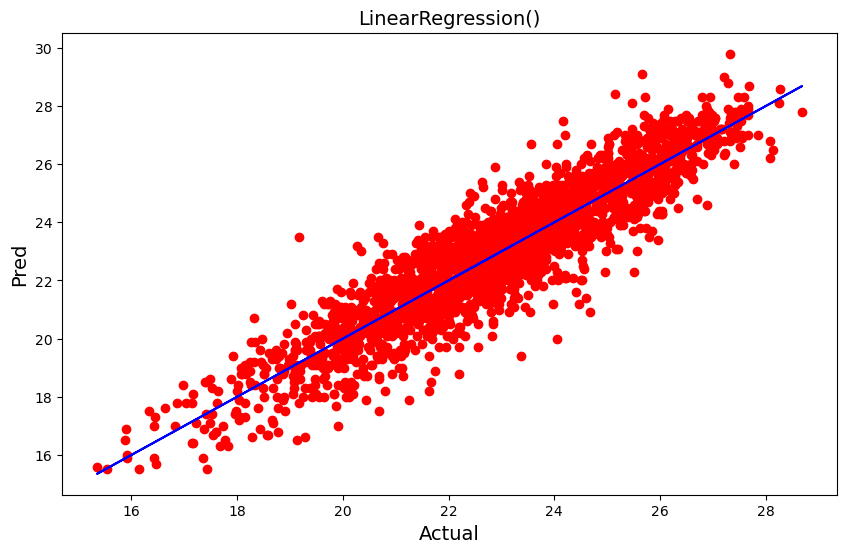

Cross Validation of:   LinearRegression()  is 
[0.65203853 0.64536986 0.78772771 0.80767959 0.85691508]
0.7499461551256633
Diff in Acc Score and Cross Val Score is -  8.412318807499952


R2_score:   RandomForestRegressor()  is  0.9050194710430105
R2_score_Training Data:   RandomForestRegressor()  is  98.6499276330963
error:
Mean Absolute error 0.5591878238341967
Mean Squared error 0.5607949434369602
Root Mean Squared error 0.7488624329187306


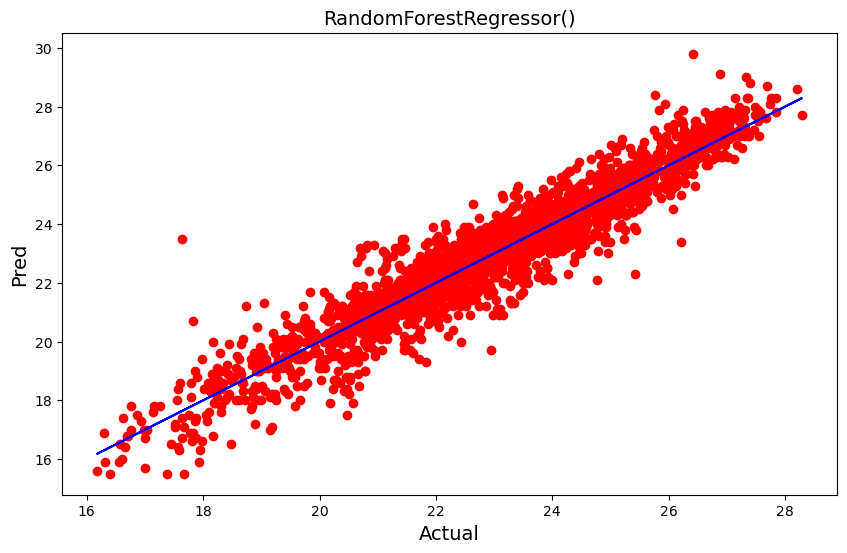

Cross Validation of:   RandomForestRegressor()  is 
[0.67963367 0.67511461 0.81295388 0.86915784 0.86371083]
0.7801141654582822
Diff in Acc Score and Cross Val Score is -  12.490530558472834


R2_score:   DecisionTreeRegressor()  is  0.7932551754893126
R2_score_Training Data:   DecisionTreeRegressor()  is  100.0
error:
Mean Absolute error 0.8117875647668393
Mean Squared error 1.2206865284974096
Root Mean Squared error 1.1048468348587552


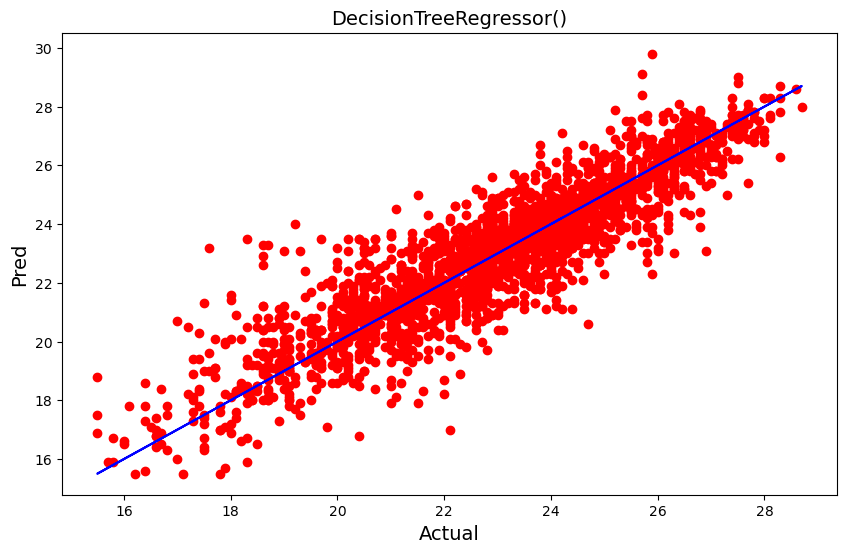

Cross Validation of:   DecisionTreeRegressor()  is 
[0.40984414 0.4620868  0.62772642 0.76159174 0.66709079]
0.5856679773490823
Diff in Acc Score and Cross Val Score is -  20.75871981402303


R2_score:   KNeighborsRegressor()  is  0.8735609552521906
R2_score_Training Data:   KNeighborsRegressor()  is  91.75978845776488
error:
Mean Absolute error 0.645293609671848
Mean Squared error 0.7465359240069086
Root Mean Squared error 0.8640231038617594


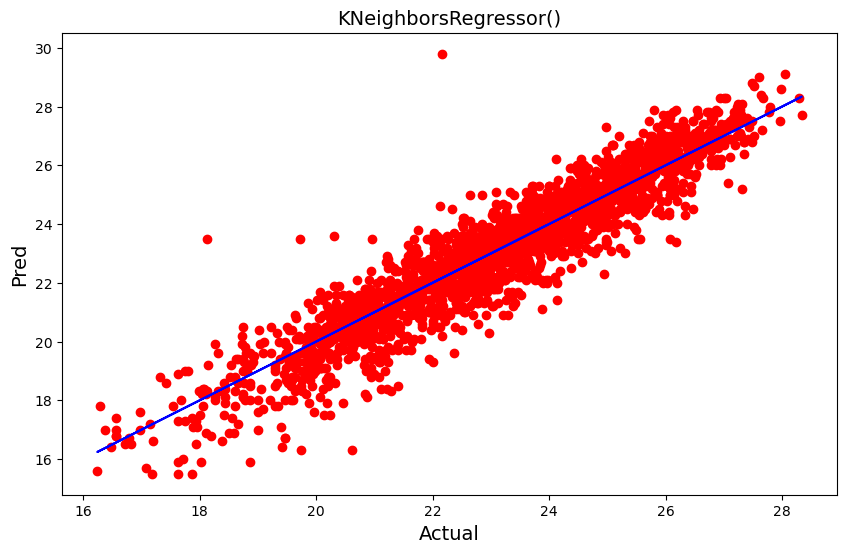

Cross Validation of:   KNeighborsRegressor()  is 
[0.47027832 0.5430833  0.71995823 0.75390384 0.77152957]
0.6517506530150619
Diff in Acc Score and Cross Val Score is -  22.181030223712874


R2_score:   Lasso()  is  0.5519915083519396
R2_score_Training Data:   Lasso()  is  52.260476229549205
error:
Mean Absolute error 1.2950428983563496
Mean Squared error 2.645183170614079
Root Mean Squared error 1.6264019093121107


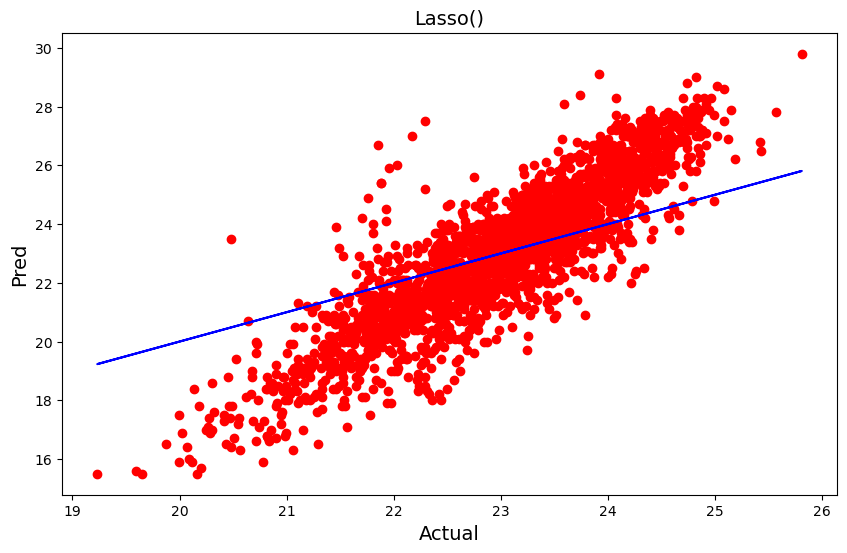

Cross Validation of:   Lasso()  is 
[0.42724656 0.3134502  0.50500546 0.39555148 0.56360891]
0.4409725218949035
Diff in Acc Score and Cross Val Score is -  11.101898645703606


R2_score:   Ridge()  is  0.8340802079308318
R2_score_Training Data:   Ridge()  is  81.53399657498444
error:
Mean Absolute error 0.7803496523993264
Mean Squared error 0.9796426849826901
Root Mean Squared error 0.9897690058709103


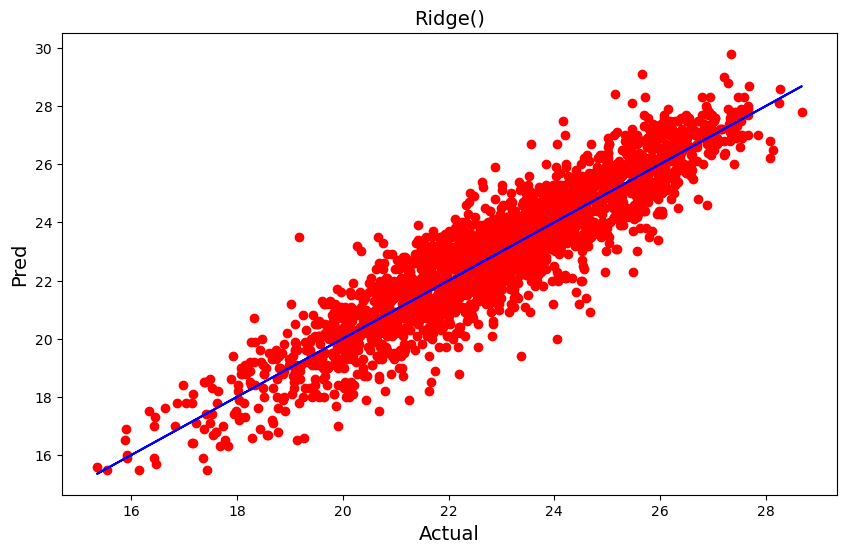

Cross Validation of:   Ridge()  is 
[0.65203305 0.64544191 0.78770652 0.80767213 0.85693512]
0.7499577472888277
Diff in Acc Score and Cross Val Score is -  8.412246064200414


R2_score:   SVR()  is  0.8884013878467969
R2_score_Training Data:   SVR()  is  90.94952972076366
error:
Mean Absolute error 0.6092550196541636
Mean Squared error 0.6589133381057393
Root Mean Squared error 0.8117347707876873


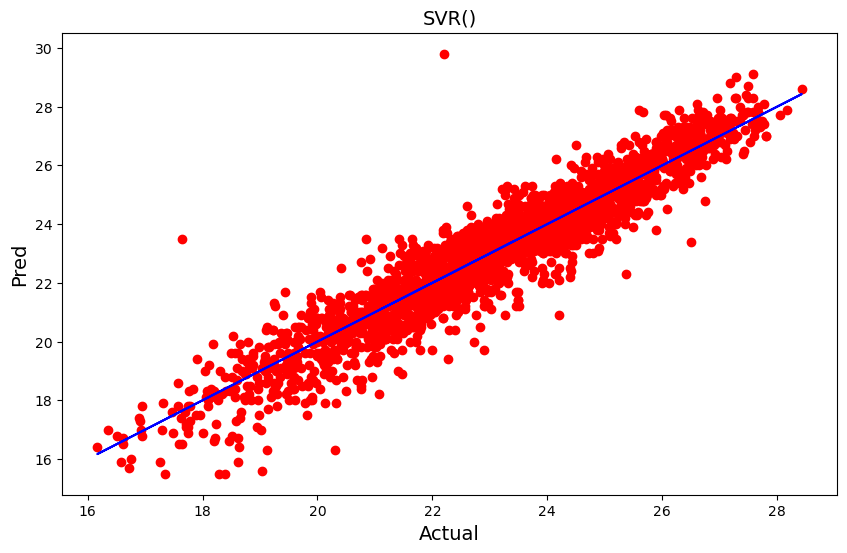

Cross Validation of:   SVR()  is 
[0.63540731 0.62310869 0.79748583 0.8281237  0.81999501]
0.7408241073622335
Diff in Acc Score and Cross Val Score is -  14.757728048456343


R2_score:   ExtraTreesRegressor()  is  0.9139478797250427
R2_score_Training Data:   ExtraTreesRegressor()  is  100.0
error:
Mean Absolute error 0.5296161485319514
Mean Squared error 0.5080788078583763
Root Mean Squared error 0.7127964701500537


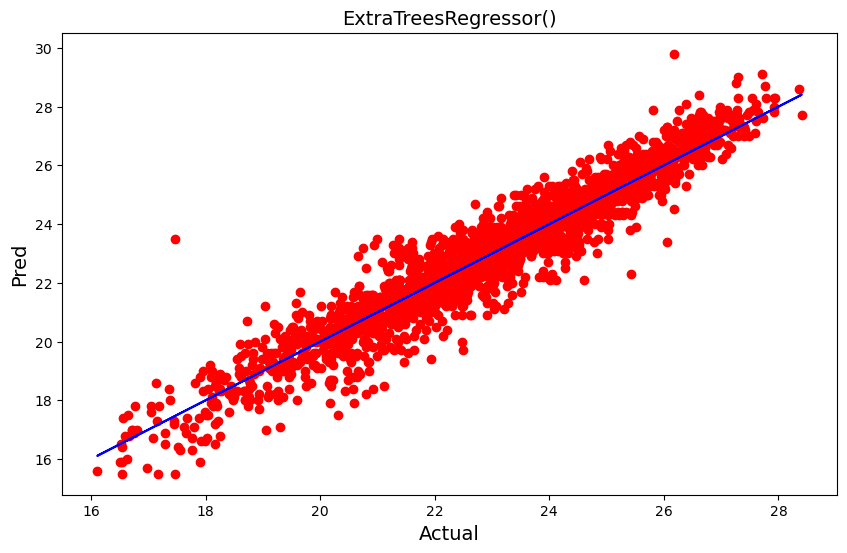

Cross Validation of:   ExtraTreesRegressor()  is 
[0.69736467 0.67573084 0.8186926  0.86331609 0.87266736]
0.785554312884484
Diff in Acc Score and Cross Val Score is -  12.839356684055868




In [63]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor,ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.linear_model import Lasso,Ridge
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score
#from sklearn.svm import SVC
#from sklearn.ensemble import GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier
#from sklearn.naive_bayes import MultinomialNB
#from sklearn.naive_bayes import GaussianNB


lr= LinearRegression()
rfc=RandomForestRegressor()
dtr=DecisionTreeRegressor()
kn=KNN()
ls=Lasso()
rd=Ridge()
svr=SVR()
etr=ExtraTreesRegressor()




model=[lr,rfc,dtr,kn,ls,rd,svr,etr]

for m in model:
    m.fit(x_train,y_train)
    predm=m.predict(x_test)
    pred_train=m.predict(x_train)
    
    print("R2_score:  ",m," is " ,r2_score(y_test,predm))
    print("R2_score_Training Data:  ",m," is " ,r2_score(y_train,pred_train)*100)
    print("error:")
    
    print("Mean Absolute error",mean_absolute_error(y_test,predm))
    print("Mean Squared error",mean_squared_error(y_test,predm))
    print("Root Mean Squared error",np.sqrt(mean_squared_error(y_test,predm)))
   
    plt.figure(figsize=(10,6))
    plt.scatter(x=predm,y=y_test,color="r")
    plt.plot(predm,predm,color="b")
    plt.xlabel("Actual",fontsize=14)
    plt.ylabel("Pred",fontsize=14)
    plt.title(m,fontsize=14)
    plt.show()
    score = cross_val_score(m,x,y)
    print("Cross Validation of:  ",m," is " )
    print(score)
    print(score.mean())
    print("Diff in Acc Score and Cross Val Score is - ",(r2_score(y_test,predm)-score.mean())*100)
    print("\n")

# ExtraTreesRegressor is the best model

# 5. Hyper Parameter Tuning

In [64]:
from sklearn.model_selection import GridSearchCV

parameters = {
    'n_estimators': [50, 100, 150],  # Number of trees in the forest
    'max_depth': [None, 10, 20],      # Maximum depth of the tree
    'min_samples_split': [2, 5, 10],  # Minimum number of samples required to split a node
    'min_samples_leaf': [1, 2, 4],    # Minimum number of samples required at each leaf node
    'bootstrap': [True, False]        # Whether bootstrap samples are used when building trees

}

GCV = GridSearchCV(ExtraTreesRegressor(), parameters, cv=5)
GCV.fit(x_train, y_train)
print(GCV.best_params_)

{'bootstrap': False, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 150}


In [65]:
Final_model = ExtraTreesRegressor(bootstrap=False, n_estimators=150, max_depth= None, min_samples_leaf= 1, min_samples_split= 2 )
Final_model.fit(x_train,y_train)
pred=Final_model.predict(x_test)
acc=r2_score(y_test,pred)
print(acc*100)

print("R2_score:",r2_score(y_test,pred))

print("Mean Absolute error",mean_absolute_error(y_test,pred))
print("Mean Squared error",mean_squared_error(y_test,pred))
print("Root Mean Squared error",np.sqrt(mean_squared_error(y_test,pred)))

91.44248659560628
R2_score: 0.9144248659560628
Mean Absolute error 0.5270935521013242
Mean Squared error 0.5052625309921325
Root Mean Squared error 0.7108182123385223


# Saving the Model

In [66]:
import joblib # save as *.pkl
joblib.dump(Final_model,"phase2_project_12_temperature.pkl")

['phase2_project_12_temperature.pkl']

In [85]:
df5 = df1

# Project2: Next_Tmax : Regression Model

In [87]:
from statsmodels.stats.outliers_influence import variance_inflation_factor
x_x = ['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_Tmax_lapse', 'LDAPS_Tmin_lapse', 'LDAPS_WS',
       'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2', 'LDAPS_CC3', 'LDAPS_CC4',
       'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4', 'lat', 'lon',
       'DEM', 'Slope', 'Solar radiation','Next_Tmin']
x = df5[x_x]
def vif_cal():
    vif=pd.DataFrame()
    vif["VIF Factor"]=[variance_inflation_factor(x.values,i) for i in range(x.shape[1])]
    vif["features"]=x.columns
    print(vif)
vif_cal()

       VIF Factor          features
0        5.078163           station
1        5.127742              Date
2      287.460884      Present_Tmax
3      317.332808      Present_Tmin
4      100.256635       LDAPS_RHmin
5      329.450911       LDAPS_RHmax
6      633.073959  LDAPS_Tmax_lapse
7      881.699487  LDAPS_Tmin_lapse
8       13.970796          LDAPS_WS
9        6.559572          LDAPS_LH
10      10.429455         LDAPS_CC1
11      15.106657         LDAPS_CC2
12      13.693127         LDAPS_CC3
13       7.120338         LDAPS_CC4
14       1.550734        LDAPS_PPT1
15       1.597028        LDAPS_PPT2
16       1.352184        LDAPS_PPT3
17       1.336811        LDAPS_PPT4
18  651336.192043               lat
19  649412.854028               lon
20       7.363981               DEM
21       5.551003             Slope
22     223.270339   Solar radiation
23     410.639092         Next_Tmin


In [89]:
columns_to_drop=["lat","lon","LDAPS_RHmin","LDAPS_RHmax","Solar radiation"] # Least co-relation with output
df5= df5.drop(columns_to_drop, axis=1)

# MODEL
## 1. Feature Scaling using Standard Scalarization

In [90]:
# to remove biasness. Standard Scaler consider Zero as mean and 1 as std dev value
y=df5["Next_Tmax"]
from sklearn.preprocessing import StandardScaler
scaler=StandardScaler()
x=pd.DataFrame(scaler.fit_transform(x),columns=x.columns)


# 2. Best random state value:

In [91]:
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_absolute_error
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score
from sklearn.ensemble import GradientBoostingRegressor


maxAccu=0
maxRS=0
for i in range (1,200):
    x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=i)
    lr = LinearRegression()
    lr.fit(x_train,y_train)
    pred = lr.predict(x_test)
    acc = r2_score(y_test,pred)
    if acc > maxAccu:
        maxAccu = acc
        maxRS=i
print("Best accuracy is", maxAccu," at random state ", maxRS)

Best accuracy is 0.798210797879428  at random state  7


# 3. Creating train test split

In [92]:
from sklearn.model_selection import train_test_split
x_train,x_test,y_train,y_test=train_test_split(x,y,test_size=0.30,random_state=maxRS)

# 4. Regression Algorithms and Cross Validation Score¶

R2_score:   LinearRegression()  is  0.798210797879428
R2_score_Training Data:   LinearRegression()  is  77.43474549939273
error:
Mean Absolute error 1.0967824676398266
Mean Squared error 2.002790640353817
Root Mean Squared error 1.4151998588022179


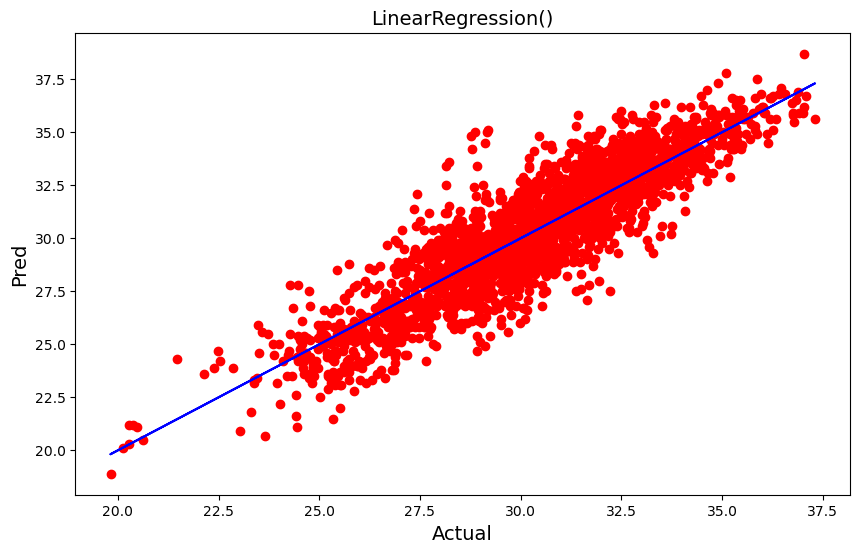

Cross Validation of:   LinearRegression()  is 
[0.68232518 0.63878286 0.68626645 0.81575254 0.71102718]
0.7068308435668806
Diff in Acc Score and Cross Val Score is -  9.13799543125473


R2_score:   RandomForestRegressor()  is  0.9147297596229457
R2_score_Training Data:   RandomForestRegressor()  is  98.66575482236765
error:
Mean Absolute error 0.6927210708117443
Mean Squared error 0.846320999999999
Root Mean Squared error 0.9199570642154986


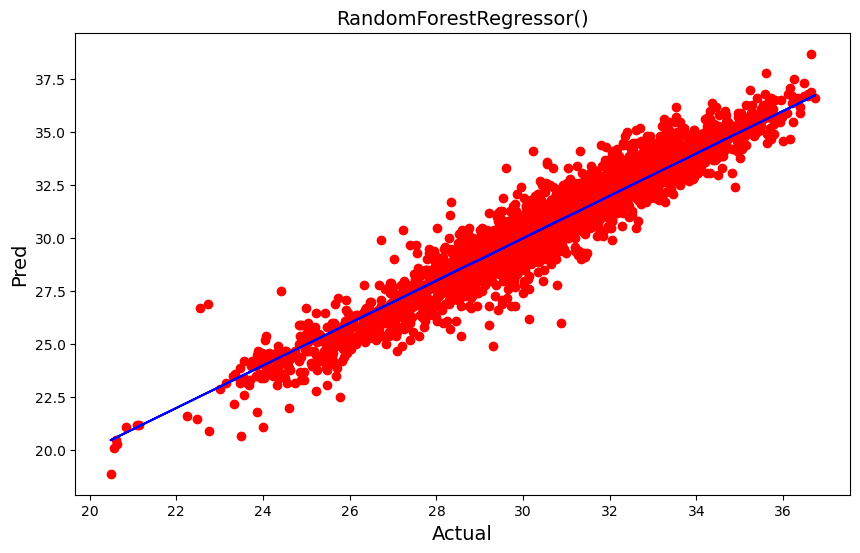

Cross Validation of:   RandomForestRegressor()  is 
[0.72126772 0.65913598 0.66777589 0.81048298 0.67402039]
0.7065365921890339
Diff in Acc Score and Cross Val Score is -  20.81931674339118


R2_score:   DecisionTreeRegressor()  is  0.7831265434858163
R2_score_Training Data:   DecisionTreeRegressor()  is  100.0
error:
Mean Absolute error 1.0352331606217615
Mean Squared error 2.1525043177892917
Root Mean Squared error 1.467141546610037


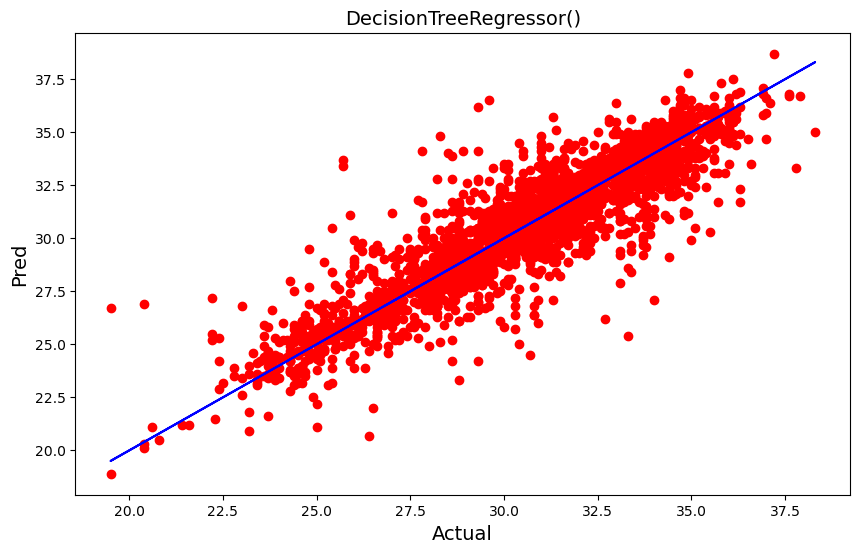

Cross Validation of:   DecisionTreeRegressor()  is 
[0.33048799 0.4488208  0.33995675 0.62818877 0.43846255]
0.4371833724881002
Diff in Acc Score and Cross Val Score is -  34.594317099771615


R2_score:   KNeighborsRegressor()  is  0.8756595894947399
R2_score_Training Data:   KNeighborsRegressor()  is  90.28842547234422
error:
Mean Absolute error 0.8431433506044904
Mean Squared error 1.2340987910189984
Root Mean Squared error 1.110899991456926


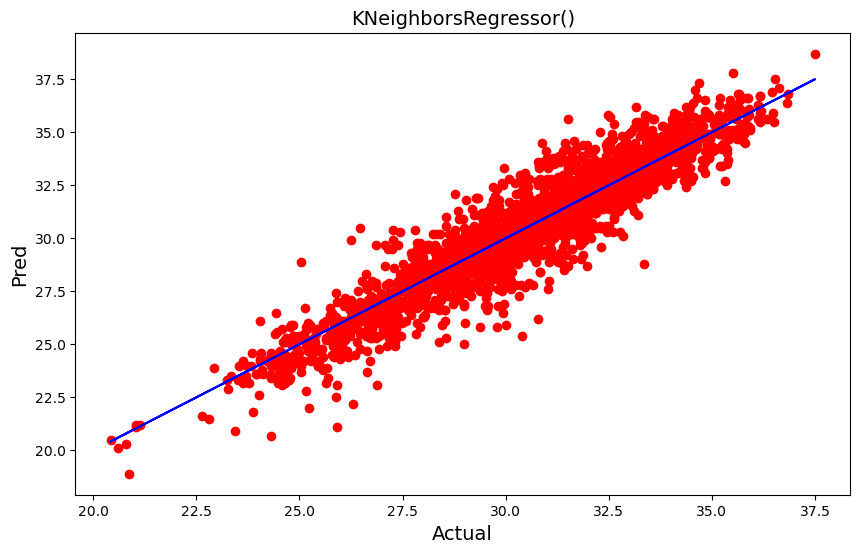

Cross Validation of:   KNeighborsRegressor()  is 
[0.64191096 0.43740555 0.51410007 0.71817734 0.65677133]
0.5936730502776675
Diff in Acc Score and Cross Val Score is -  28.19865392170724


R2_score:   Lasso()  is  0.5154986545510036
R2_score_Training Data:   Lasso()  is  49.79246251987276
error:
Mean Absolute error 1.769240697663961
Mean Squared error 4.8087546296172965
Root Mean Squared error 2.192887281557649


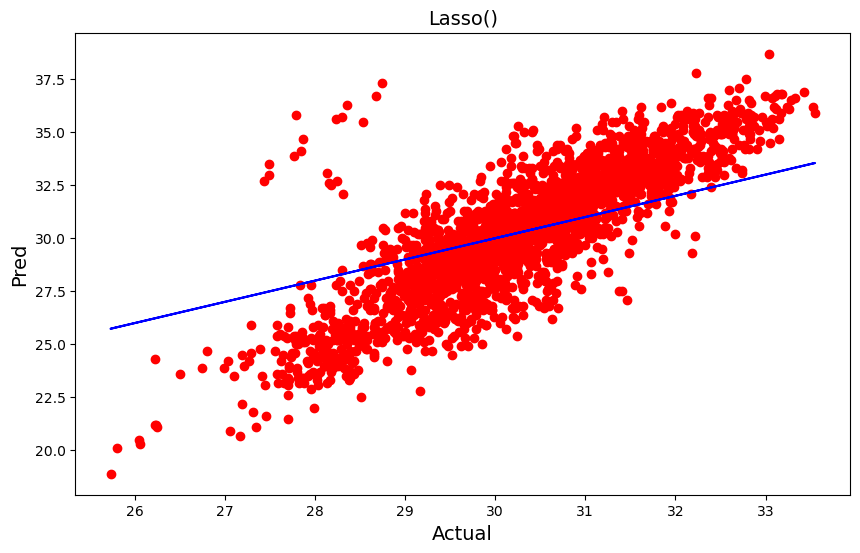

Cross Validation of:   Lasso()  is 
[0.33004779 0.44495275 0.51027072 0.28859095 0.51351239]
0.4174749196156606
Diff in Acc Score and Cross Val Score is -  9.802373493534306


R2_score:   Ridge()  is  0.798213568174218
R2_score_Training Data:   Ridge()  is  77.43472492491222
error:
Mean Absolute error 1.0967813795590258
Mean Squared error 2.002763144727598
Root Mean Squared error 1.4151901443719845


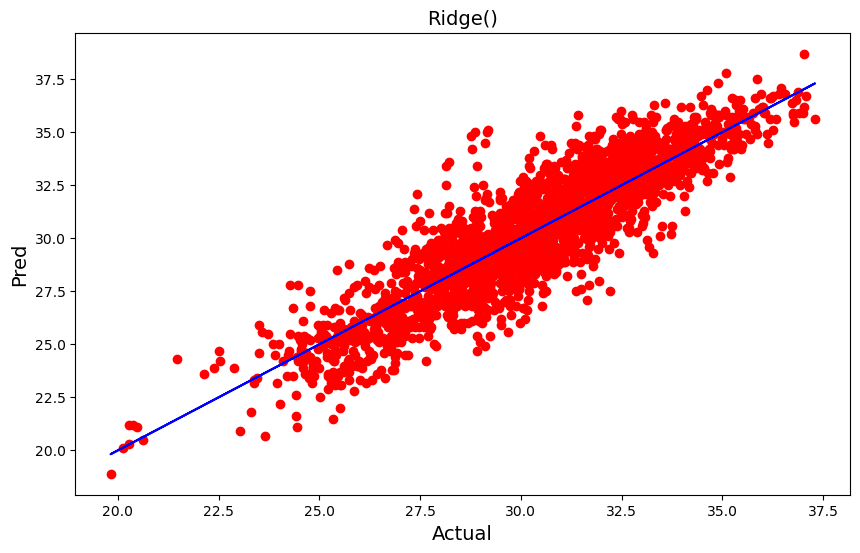

Cross Validation of:   Ridge()  is 
[0.68247929 0.63875754 0.68623436 0.8157551  0.71103146]
0.706851551809764
Diff in Acc Score and Cross Val Score is -  9.136201636445396


R2_score:   SVR()  is  0.8876147000438233
R2_score_Training Data:   SVR()  is  88.68342739029042
error:
Mean Absolute error 0.7877196886079262
Mean Squared error 1.1154423750141786
Root Mean Squared error 1.0561450539647377


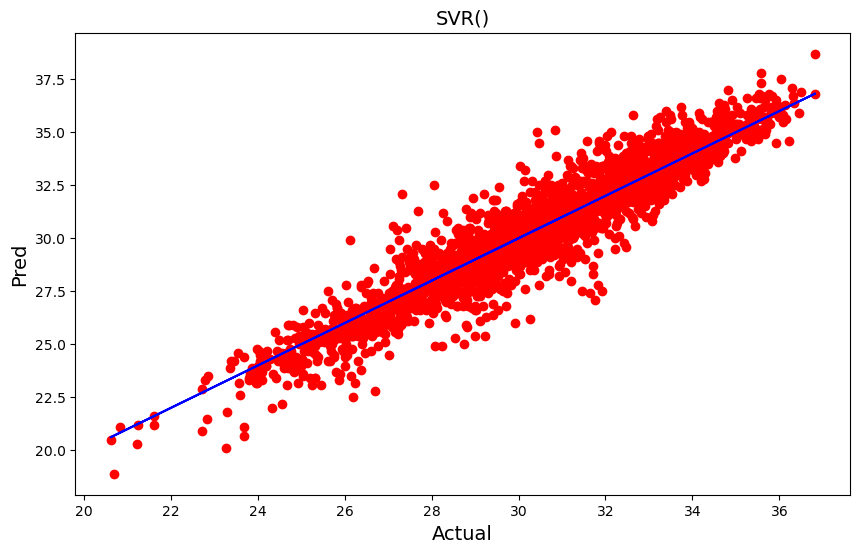

Cross Validation of:   SVR()  is 
[0.72575436 0.60716129 0.67497287 0.80427462 0.70556666]
0.7035459582300567
Diff in Acc Score and Cross Val Score is -  18.406874181376654


R2_score:   ExtraTreesRegressor()  is  0.9318722772426347
R2_score_Training Data:   ExtraTreesRegressor()  is  100.0
error:
Mean Absolute error 0.6296649395509498
Mean Squared error 0.6761787253886006
Root Mean Squared error 0.822300872788422


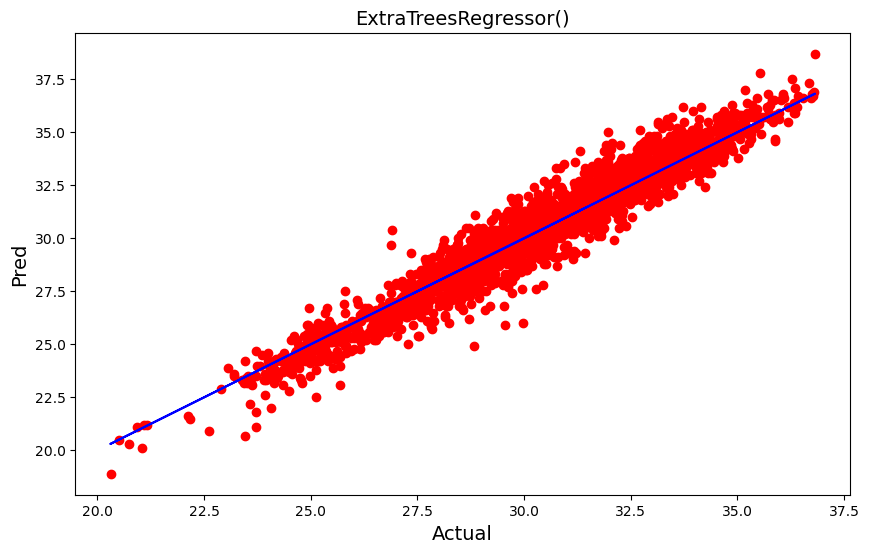

Cross Validation of:   ExtraTreesRegressor()  is 
[0.71463092 0.64242004 0.68757028 0.83635086 0.69982639]
0.7161596962863893
Diff in Acc Score and Cross Val Score is -  21.571258095624536




In [93]:
from sklearn.linear_model import LinearRegression
from sklearn.ensemble import RandomForestRegressor,ExtraTreesRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor as KNN
from sklearn.linear_model import Lasso,Ridge
from sklearn.svm import SVR
from sklearn.model_selection import cross_val_score
#from sklearn.svm import SVC
#from sklearn.ensemble import GradientBoostingClassifier,AdaBoostClassifier,BaggingClassifier
#from sklearn.naive_bayes import MultinomialNB
#from sklearn.naive_bayes import GaussianNB


lr= LinearRegression()
rfc=RandomForestRegressor()
dtr=DecisionTreeRegressor()
kn=KNN()
ls=Lasso()
rd=Ridge()
svr=SVR()
etr=ExtraTreesRegressor()




model=[lr,rfc,dtr,kn,ls,rd,svr,etr]

for m in model:
    m.fit(x_train,y_train)
    predm=m.predict(x_test)
    pred_train=m.predict(x_train)
    
    print("R2_score:  ",m," is " ,r2_score(y_test,predm))
    print("R2_score_Training Data:  ",m," is " ,r2_score(y_train,pred_train)*100)
    print("error:")
    
    print("Mean Absolute error",mean_absolute_error(y_test,predm))
    print("Mean Squared error",mean_squared_error(y_test,predm))
    print("Root Mean Squared error",np.sqrt(mean_squared_error(y_test,predm)))
   
    plt.figure(figsize=(10,6))
    plt.scatter(x=predm,y=y_test,color="r")
    plt.plot(predm,predm,color="b")
    plt.xlabel("Actual",fontsize=14)
    plt.ylabel("Pred",fontsize=14)
    plt.title(m,fontsize=14)
    plt.show()
    score = cross_val_score(m,x,y)
    print("Cross Validation of:  ",m," is " )
    print(score)
    print(score.mean())
    print("Diff in Acc Score and Cross Val Score is - ",(r2_score(y_test,predm)-score.mean())*100)
    print("\n")

#  ExtraTreesRegressor is the best model with least error

In [94]:
from sklearn.model_selection import GridSearchCV

param_grid = {
    'n_estimators': [50, 100, 150],
    'max_depth': [None, 10, 20, 30],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'bootstrap': [True, False]
}

GCV = GridSearchCV(ExtraTreesRegressor(), param_grid, cv=5)
GCV.fit(x_train, y_train)
print(GCV.best_params_)

{'bootstrap': False, 'max_depth': None, 'min_samples_leaf': 1, 'min_samples_split': 2, 'n_estimators': 150}


In [95]:
Final_model = ExtraTreesRegressor(bootstrap=False, n_estimators=150, max_depth= None, min_samples_leaf= 1, min_samples_split= 2 )
Final_model.fit(x_train,y_train)
pred=Final_model.predict(x_test)
acc=r2_score(y_test,pred)
print(acc*100)

print("R2_score:",r2_score(y_test,pred))

print("Mean Absolute error",mean_absolute_error(y_test,pred))
print("Mean Squared error",mean_squared_error(y_test,pred))
print("Root Mean Squared error",np.sqrt(mean_squared_error(y_test,pred)))

93.32454119569547
R2_score: 0.9332454119569548
Mean Absolute error 0.6222642487046621
Mean Squared error 0.6625501400882727
Root Mean Squared error 0.8139718300336153


In [96]:
import joblib # save as *.pkl
joblib.dump(Final_model,"phase2_project_12_temperature_v2.pkl")

['phase2_project_12_temperature_v2.pkl']